R environment

In [ ]:
suppressPackageStartupMessages({
    library(reticulate)
    library(ggplot2)
    library(scater)
    library(Seurat)
    library(dplyr)
    library(tidyr)
    library(purrr)
    library(rlog)
    library(tibble)
    library(stringr)
    library(dittoSeq)
    library(patchwork)
    library(future)
    library(UCell)
    library(data.table)
    library(HGNChelper)
    plan("multiprocess", workers = 8)
    options(future.globals.maxSize = 1000 * 1024^5)
    options(stringsAsFactors = FALSE)
    set.seed(123)
})

### Extract data from anndata object and input to Seurat

In [ ]:
use_condaenv("scarches")

In [ ]:
sc <- import("scanpy")
adata <- sc$read_h5ad("scarches_models/ref_model_scanvi/scarches_SCANVI_cells_5000hvg.h5ad")
adata

AnnData object with n_obs × n_vars = 338564 × 5000
    obs: 'author', 'patient', 'celltype_malignant', 'celltype_major', 'celltype_minor', 'gender', 'location', 'EGFR', 'platform', 'method', 'age', 'MET', 'p53', 'TERT', 'ATRX', 'PTEN', 'MGMT', 'sample', 'celltype_original', 'KI_67', 'region', 'Tissue', 'chr1p19q', 'stage', 'Verhaak_classification', 'PDGFR', 'gs_prediction', 'gs_prediction_main', 'gs_prediction_detailed', 'cnv_full_geneset', 'cnv_filtered_geneset', 'celltype_assigned', '_scvi_batch', '_scvi_labels', '_scvi_local_l_mean', '_scvi_local_l_var'
    var: 'gene_ids', 'feature_types', 'genome', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'highly_variable_nbatches', 'highly_variable_intersection'
    uns: '_scvi', 'hvg'
    layers: 'counts'

In [ ]:
reference_latent <- sc$read_h5ad("scarches_models/ref_model_scanvi/scarches_SCANVI_cells_5000hvg_latent.h5ad")
reference_latent

AnnData object with n_obs × n_vars = 338564 × 10
    obs: 'celltype_assigned', 'celltype_original', 'author', 'platform', 'method', 'gs_prediction_main', 'gs_prediction_detailed', 'patient', 'gender', 'cnv_filtered_geneset', 'cnv_full_geneset', 'leiden', 'predictions'
    uns: 'author_colors', 'celltype_assigned_colors', 'celltype_original_colors', 'cnv_filtered_geneset_colors', 'cnv_full_geneset_colors', 'gs_prediction_detailed_colors', 'gs_prediction_main_colors', 'leiden', 'leiden_colors', 'neighbors', 'platform_colors', 'umap'
    obsm: 'X_umap'
    obsp: 'connectivities', 'distances'

### Format count and normalized data for their respective slots

In [ ]:
counts <- t(adata$layers["counts"])
colnames(counts) <- adata$obs_names$to_list()
rownames(counts) <- adata$var_names$to_list()
counts <- Matrix::Matrix(as.matrix(counts), sparse = T)

data <- t(adata$X)
colnames(data) <- adata$obs_names$to_list()
rownames(data) <- adata$var_names$to_list()
data <- Matrix::Matrix(as.matrix(data), sparse = T)

### Create the Seurat object

In [ ]:
reference <- CreateSeuratObject(counts)
reference <- SetAssayData(reference, "data", data)
reference <- AddMetaData(reference, adata$obs)
str(reference)

Warning message:
“Invalid name supplied, making object name syntactically valid. New object name is authorpatientcelltype_malignantcelltype_majorcelltype_minorgenderlocationEGFRplatformmethodageMETp53TERTATRXPTENMGMTsamplecelltype_originalKI_67regionTissuechr1p19qstageVerhaak_classificationPDGFRgs_predictiongs_prediction_maings_prediction_detailedcnv_full_genesetcnv_filtered_genesetcelltype_assignedX_scvi_batchX_scvi_labelsX_scvi_local_l_meanX_scvi_local_l_var; see ?make.names for more details on syntax validity”


Formal class 'Seurat' [package "SeuratObject"] with 13 slots
  ..@ assays      :List of 1
  .. ..$ RNA:Formal class 'Assay' [package "SeuratObject"] with 8 slots
  .. .. .. ..@ counts       :Formal class 'dgCMatrix' [package "Matrix"] with 6 slots
  .. .. .. .. .. ..@ i       : int [1:183680850] 1 8 9 10 15 21 23 29 30 31 ...
  .. .. .. .. .. ..@ p       : int [1:338565] 0 1167 2217 3142 4061 5094 6137 6859 7809 8614 ...
  .. .. .. .. .. ..@ Dim     : int [1:2] 5000 338564
  .. .. .. .. .. ..@ Dimnames:List of 2
  .. .. .. .. .. .. ..$ : chr [1:5000] "TRIM63" "CCP110" "STARD8" "CCDC186" ...
  .. .. .. .. .. .. ..$ : chr [1:338564] "PJ017_0" "PJ017_1" "PJ017_2" "PJ017_3" ...
  .. .. .. .. .. ..@ x       : num [1:183680850] 1 2 1 5 115 1 1 3 2 1 ...
  .. .. .. .. .. ..@ factors : list()
  .. .. .. ..@ data         :Formal class 'dgCMatrix' [package "Matrix"] with 6 slots
  .. .. .. .. .. ..@ i       : int [1:183680850] 1 8 9 10 15 21 23 29 30 31 ...
  .. .. .. .. .. ..@ p       : int [1:

### Import dim. reductions

In [ ]:
# set embeddings
embedding <- reference_latent$obsm["X_umap"]
rownames(embedding) <- adata$obs_names$to_list() # obs_names from reference_latent does not have cellIDs (only indexes)
colnames(embedding) <- c("umap_1", "umap_2")
reference[["umap"]] <- CreateDimReducObject(embedding, key = "umap_")

# set UMAP models
umap.new.model <- list()
umap.new.model$n_epochs <- 500
umap.new.model$alpha <-1
umap.new.model$method <- "umap"
umap.new.model$negative_sample_rate <- 5
umap.new.model$gamma <- 1
umap.new.model$approx_pow <- 0
umap.new.model$metric$cosine <- list()
umap.new.model$embedding <- reference[["umap"]]@cell.embeddings
ab_param <- uwot:::find_ab_params(spread = 1, min_dist = 0.3)
umap.new.model$a <- ab_param["a"]
umap.new.model$b <- ab_param["b"]
reference[["umap"]]@misc$model <- umap.new.model

Warning message:
“No assay specified, setting assay as RNA by default.”


Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



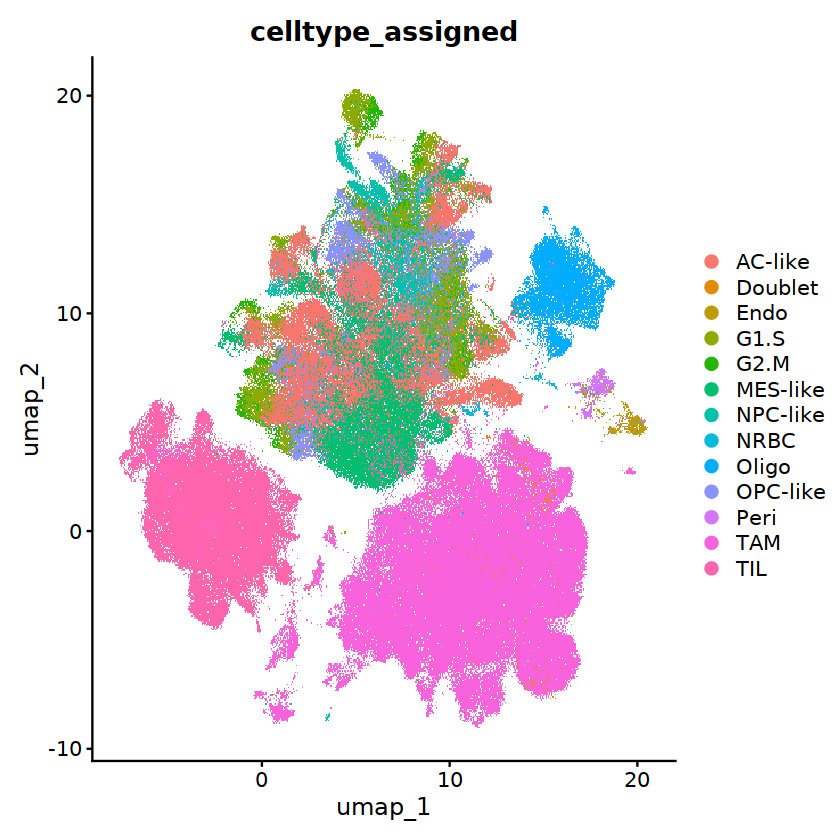

In [ ]:
DimPlot(reference, group.by = 'celltype_assigned') 

In [ ]:
rm(adata)
rm(counts)
rm(data)

Warning message:
“ggrepel: 14 unlabeled data points (too many overlaps). Consider increasing max.overlaps”


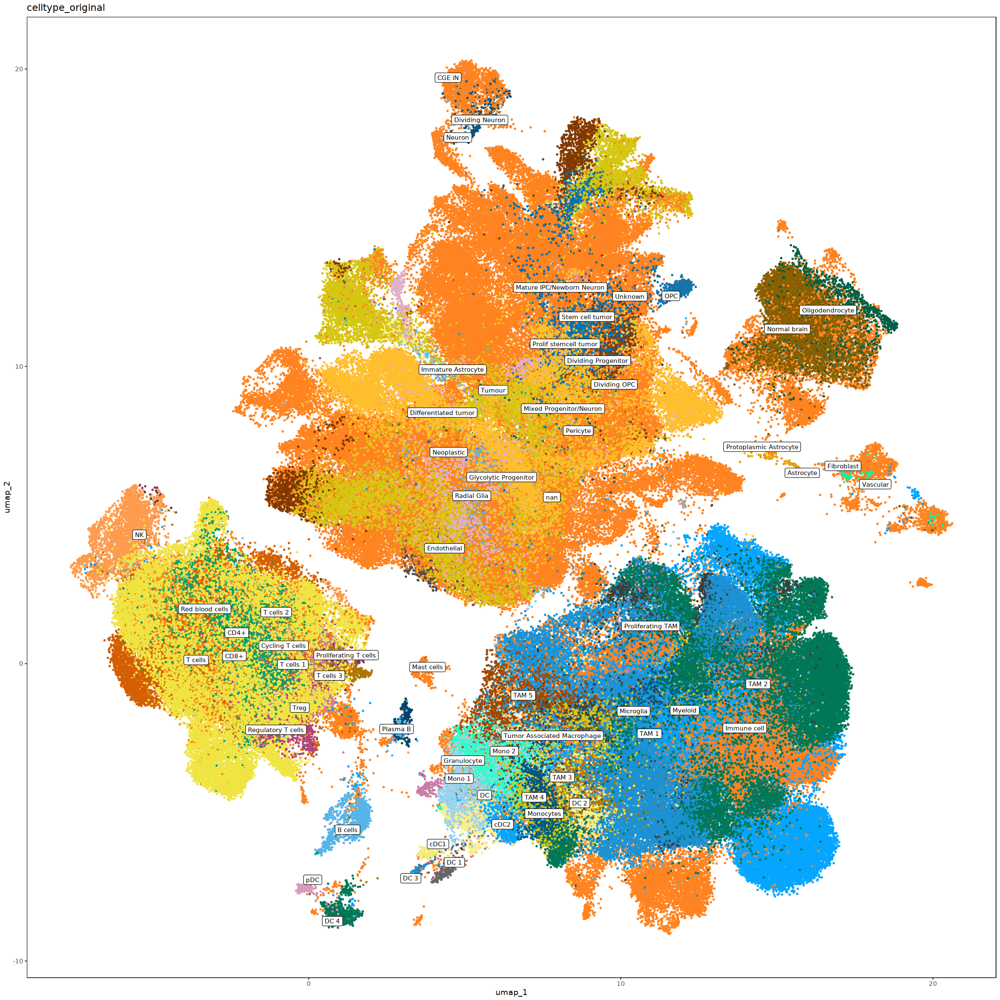

In [ ]:
options(repr.plot.height = 20, repr.plot.width = 20)
dittoDimPlot(reference, reduction.use = "umap", var = "celltype_original", 
                       do.label = T, labels.size = 3) + NoLegend()

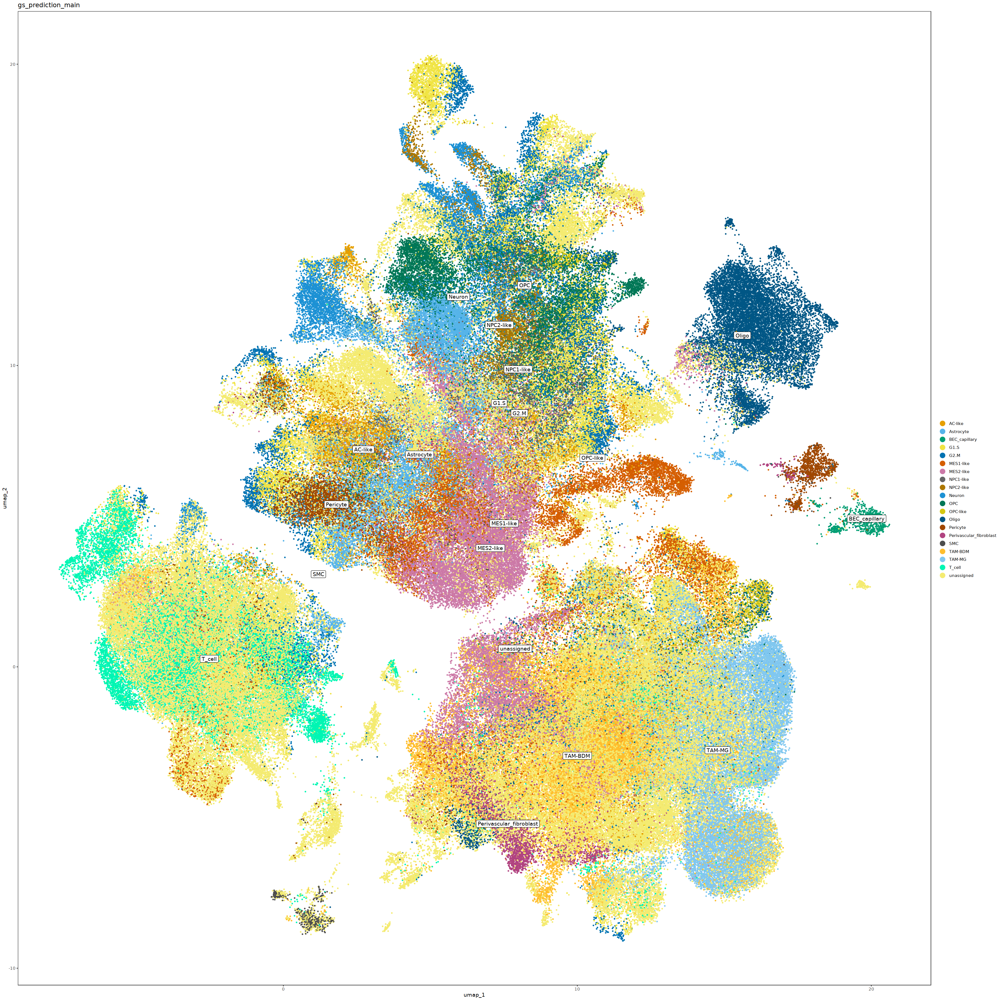

In [ ]:
options(repr.plot.height = 30, repr.plot.width = 30)
dittoDimPlot(reference, reduction.use = "umap", var = "gs_prediction", 
                       do.label = T, labels.size = 4)

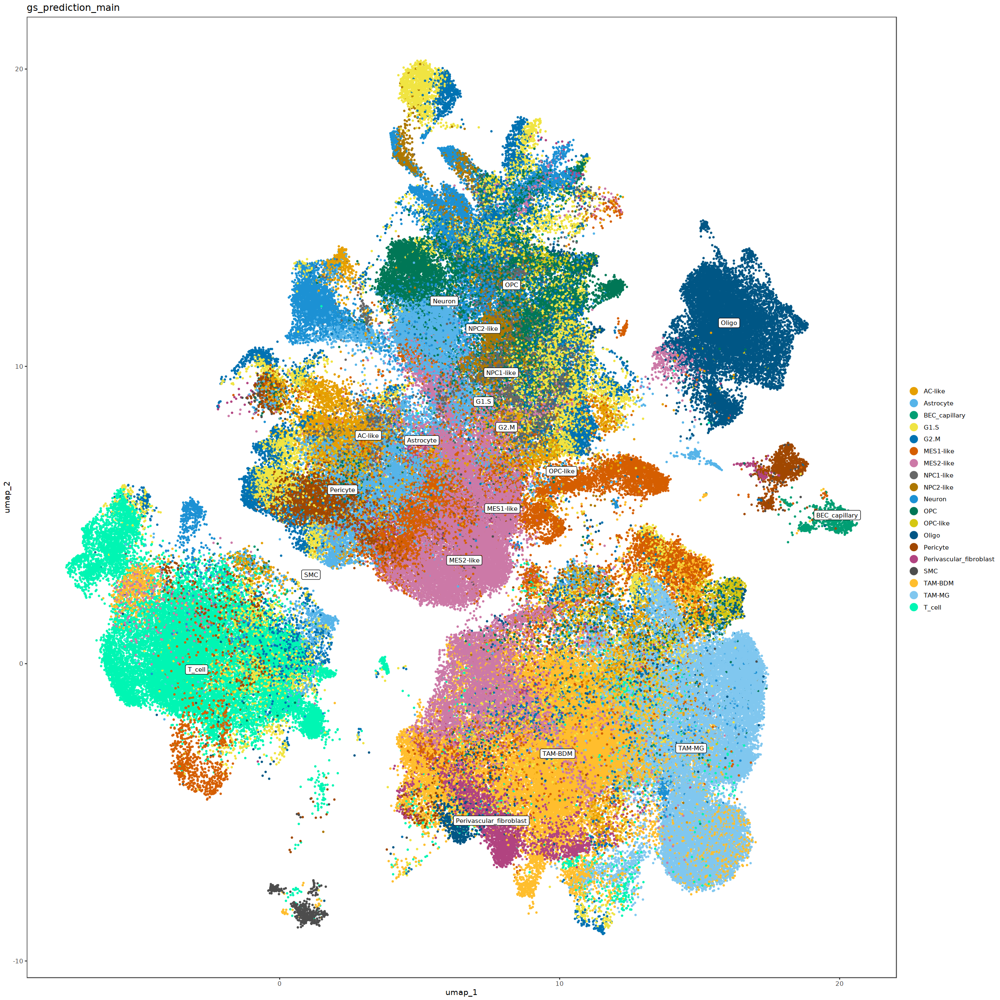

In [ ]:
options(repr.plot.height = 20, repr.plot.width = 20)
dittoDimPlot(subset(reference, subset = gs_prediction == 'unassigned', invert = TRUE), 
             reduction.use = "umap", var = "gs_prediction", 
             do.label = T, labels.size = 3)

Warning message:
“ggrepel: 13 unlabeled data points (too many overlaps). Consider increasing max.overlaps”


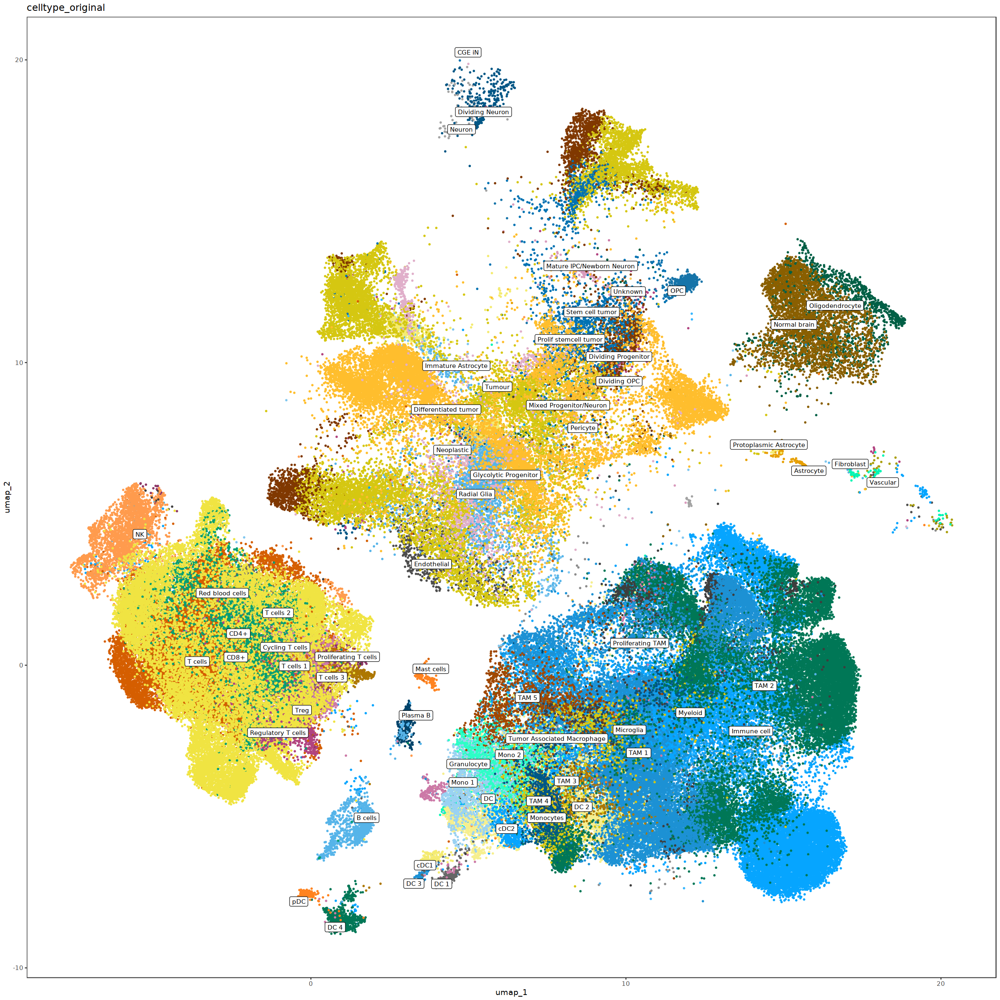

In [ ]:
options(repr.plot.height = 20, repr.plot.width = 20)
dittoDimPlot(subset(reference, subset = celltype_original == 'nan', invert = TRUE), 
             reduction.use = "umap", var = "celltype_original", 
             do.label = T, labels.size = 3) + NoLegend()

### Assigning cell identity

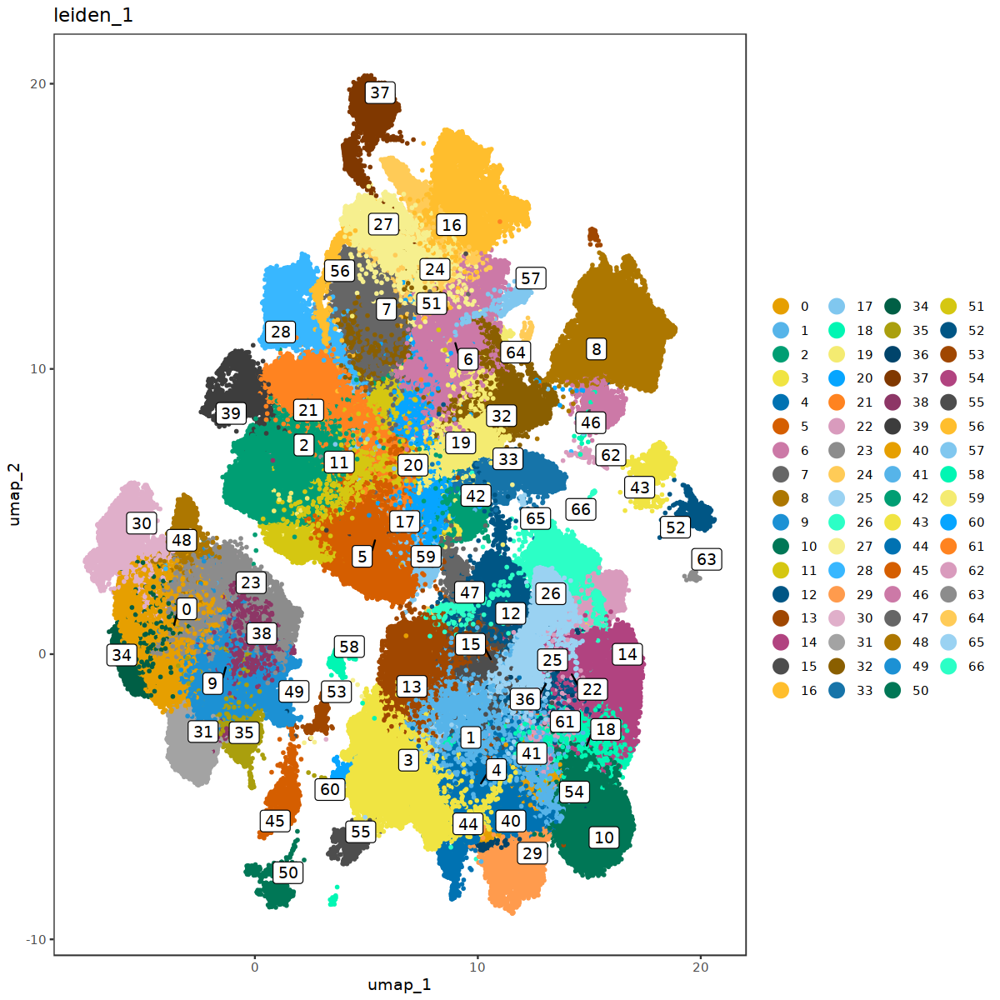

In [ ]:
reference <- AddMetaData(reference, reference_latent$obs['leiden_1'] %>% `rownames<-` (colnames(reference)))
options(repr.plot.height = 10, repr.plot.width = 10)
dittoDimPlot(reference, reduction.use = "umap", var = "leiden_1", 
                       do.label = T, labels.size = 4)

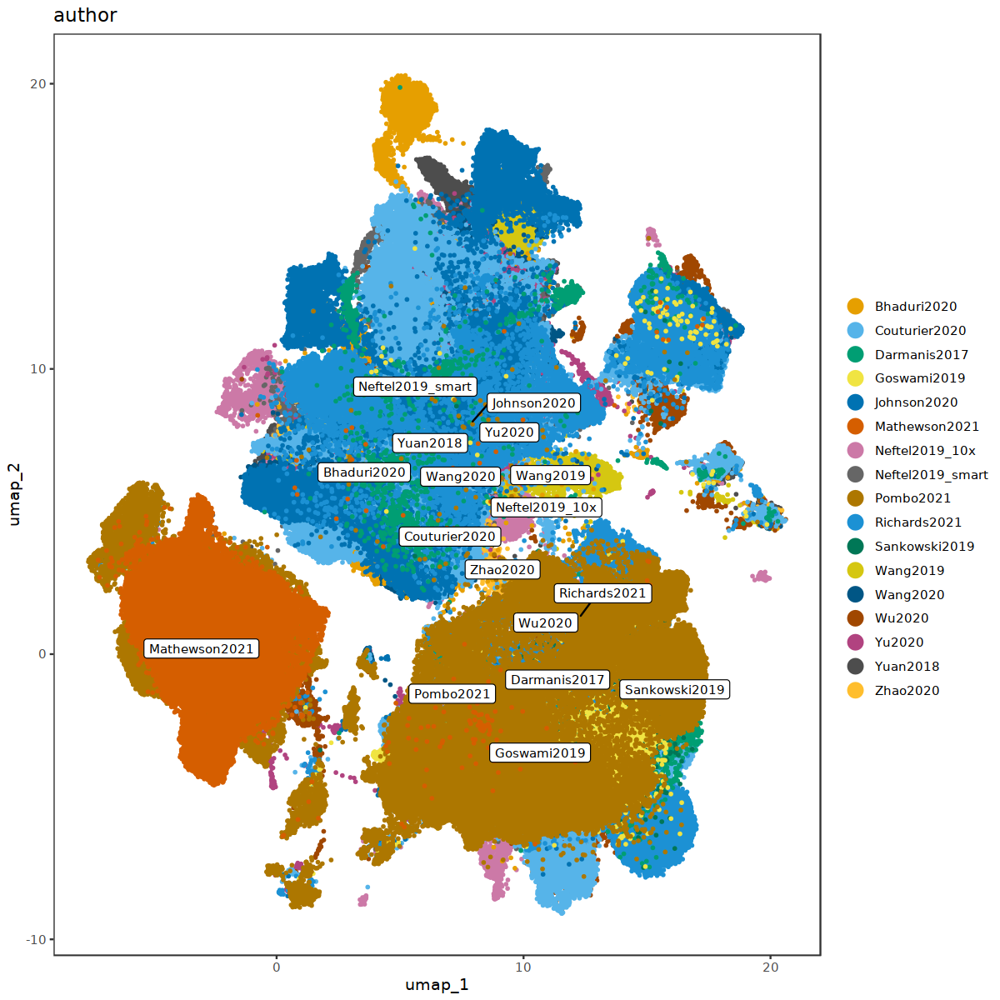

In [ ]:
options(repr.plot.height = 10, repr.plot.width = 10)
dittoDimPlot(reference, 
             reduction.use = "umap", var = "author", 
             do.label = T, labels.size = 3)

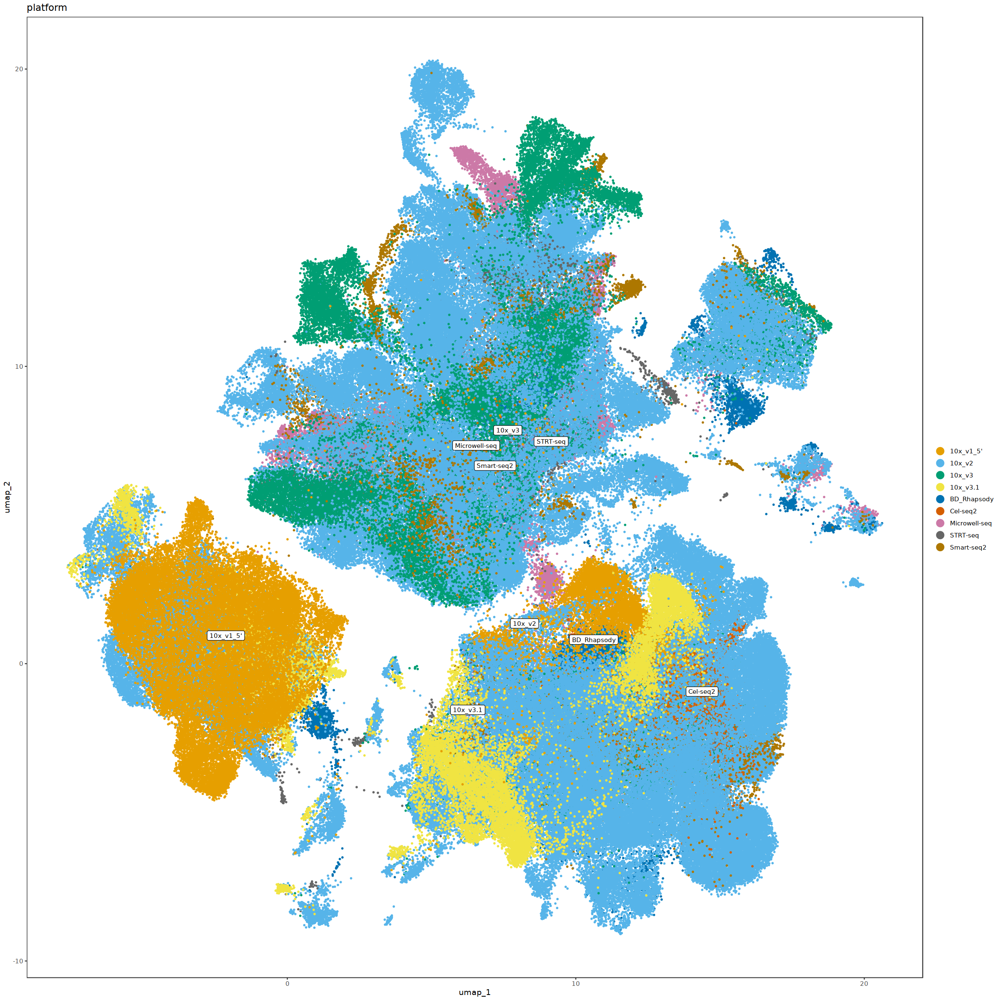

In [ ]:
options(repr.plot.height = 20, repr.plot.width = 20)
dittoDimPlot(reference, 
             reduction.use = "umap", var = "platform", 
             do.label = T, labels.size = 3)

In [ ]:
Idents(reference) <- reference@meta.data$`leiden_1`
markers <- FindAllMarkers(reference, only.pos = TRUE, min.pct = 0.25, logfc.threshold = 0.25)

Calculating cluster 0

Calculating cluster 1

Calculating cluster 2

Calculating cluster 3

Calculating cluster 4

Calculating cluster 5

Calculating cluster 7

Calculating cluster 8

Calculating cluster 9

Calculating cluster 10

Calculating cluster 11

Calculating cluster 12

Calculating cluster 13

Calculating cluster 14

Calculating cluster 15

Calculating cluster 16

Calculating cluster 17

Calculating cluster 18

Calculating cluster 19

Calculating cluster 20

Calculating cluster 21

Calculating cluster 22

Calculating cluster 23

Calculating cluster 24

Calculating cluster 25

Calculating cluster 26

Calculating cluster 27

Calculating cluster 28

Calculating cluster 29

Calculating cluster 30

Calculating cluster 31

Calculating cluster 32

Calculating cluster 33

Calculating cluster 34

Calculating cluster 35

Calculating cluster 36

Calculating cluster 37

Calculating cluster 38

Calculating cluster 39

Calculating cluster 40

Calculating cluster 41

Calculating cluster 42

C

In [ ]:
reference@misc$markers_leiden1 <- markers

For cell annotation, we considered the results from the automatic cell annotation, the original cell label (when available), <br>
the infered CNV information, the cell-type annotation available on the TISCH website (Sun et al., 2021) (when available), <br>
and the expression of cell type-specific marker genes identified using the Wilcoxon rank-sum test <br>
by comparing all cells within a specific cluster to all cells outside said cluster. 

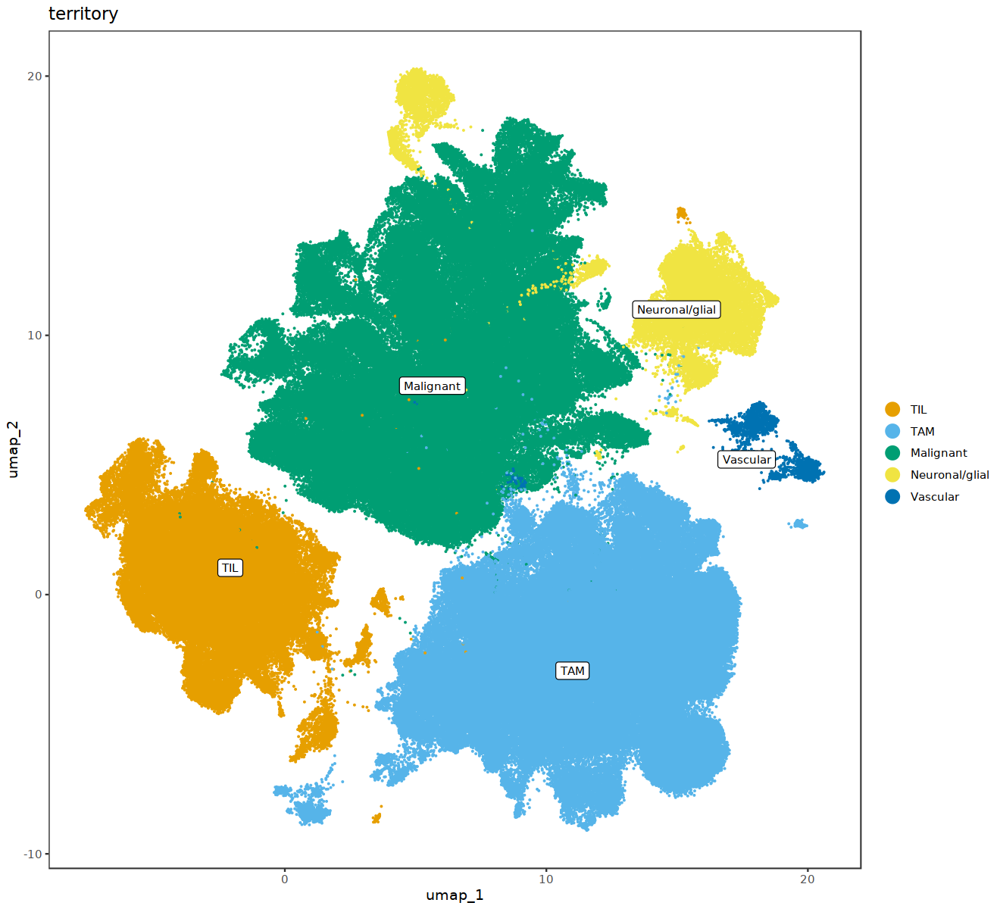

In [ ]:
Idents(reference) <- reference@meta.data$`leiden_1`
reference <- RenameIdents(reference, `0` = "TIL",
                    `1` = "TAM",
                    `2` = "Malignant", 
                    `3` = "TAM", 
                    `4` = "TAM", 
                    `5` = "Malignant", 
                    `6` = "Malignant", 
                    `7` = "Malignant", 
                    `8` = "Neuronal/glial", 
                    `9` = "TIL",
                    `10` = "TAM",
                    `11` = "Malignant", 
                    `12` = "TAM", 
                    `13` = "TAM", 
                    `14` = "TAM",
                    `15` = "TAM",
                    `16` = "Malignant", 
                    `17` = "Malignant", 
                    `18` = "TAM", 
                    `19` = "Malignant", 
                    `20` = "Malignant", 
                    `21` = "Malignant", 
                    `22` = "TAM", 
                    `23` = "TIL",
                    `24` = "Malignant",
                    `25` = "TAM", 
                    `26` = "TAM", 
                    `27` = "Malignant", 
                    `28` = "Malignant",
                    `29` = "TAM",
                    `30` = "TIL", 
                    `31` = "TIL", 
                    `32` = "Malignant", 
                    `33` = "Malignant", 
                    `34` = "TIL", 
                    `35` = "TIL", 
                    `36` = "TAM", 
                    `37` = "Neuronal/glial",
                    `38` = "TIL",
                    `39` = "Malignant", 
                    `40` = "TAM", 
                    `41` = "TAM", 
                    `42` = "Malignant",
                    `43` = "Vascular",
                    `44` = "TAM", 
                    `45` = "TIL", 
                    `46` = "Neuronal/glial", 
                    `47` = "TAM", 
                    `48` = "TIL", 
                    `49` = "TIL", 
                    `50` = "TAM", 
                    `51` = "Malignant",
                    `52` = "Vascular",
                    `53` = "TIL", 
                    `54` = "TAM", 
                    `55` = "TAM", 
                    `56` = "Malignant",
                    `57` = "Neuronal/glial",
                    `58` = "TAM", 
                    `59` = "Malignant", 
                    `60` = "TAM", 
                    `61` = "TAM", 
                    `62` = "Neuronal/glial", 
                    `63` = "TAM", 
                    `64` = "Malignant", 
                    `65` = "Neuronal/glial",
                    `66` = "Neuronal/glial"
                        )

reference$territory <- Idents(reference)
options(repr.plot.height = 10, repr.plot.width = 11)
dittoDimPlot(reference, 
             reduction.use = "umap", var = "territory", 
             do.label = T, labels.size = 3, size = 0.5)

Exporting filtered cells per cell compartment

In [ ]:
write.table(as.data.frame(Idents(subset(reference, idents = 'Malignant')))%>% 
            'data/filtered_malignant.csv', 
            row.names = TRUE, col.names = TRUE, quote = FALSE, sep = ',')

In [ ]:
TILs <- subset(reference, idents = 'TIL')
TILs <- subset(TILs, subset = c(Leiden == '45' | Leiden == '53' ), invert = TRUE) # exclude plasma and B cells
write.table(as.data.frame(Idents(TILs))%>% , 
            'data/filtered_lymphoid.csv', 
            row.names = TRUE, col.names = TRUE, quote = FALSE, sep = ',')

In [ ]:
TAMs <- subset(reference, idents = 'TIL')
TAMs <- subset(TAMs, subset = c(Leiden == '50' | Leiden == '55' | Leiden == '58'), 
               invert = TRUE) # exclude Mast and DC
write.table(as.data.frame(Idents(TAMs)), 
            'data/filtered_myeloid.csv', 
            row.names = TRUE, col.names = TRUE, quote = FALSE, sep = ',')

In [ ]:
write.table(as.data.frame(Idents(subset(reference, idents = 'Vascular')))%>% 
            'data/filtered_vascular.csv', 
            row.names = TRUE, col.names = TRUE, quote = FALSE, sep = ',')

In [ ]:
saveRDS(reference, 'data/coarse_annotation_GBmap.rds')